## 1. Imports and Setting up Env

In [ ]:
import numpy as np
import pandas as pd
import bs4
import glob
import os, shutil
import cv2
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow
from sklearn.model_selection import train_test_split
# %load_ext tensorboard.notebook
%load_ext tensorboard


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pwd

/content/drive/MyDrive/Deep_Learning_Project1


In [ ]:
# PATH = "/content/drive/MyDrive"
PATH = "/content/drive/MyDrive/Deep_Learning_Project1"
import os
os.chdir(PATH)


**<h1> 2. Defining Functions for extracting and preprocessing data**





In [ ]:
BATCH_SIZE = 32
IMAGE_SHAPE = (225, 225)
annots_path = os.path.join("dataset", "annotations")
images_path = os.path.join("dataset", "images")

In [ ]:
# Defining Functions 

def getBoundingBox(filePath, image_shape=IMAGE_SHAPE):  # --> None
    '''
    Function takes filePath of annot file and returns xmin, ymin, xmax, ymax 
    '''
    # data = tf.io.read_file(filePath).numpy().decode()
    with open(filePath, 'r') as f:
      data = f.read()

    bs = bs4.BeautifulSoup(data)

    xmin = int(bs.find("xmin").get_text())
    ymin = int(bs.find("ymin").get_text())
    xmax=  int(bs.find("xmax").get_text())
    ymax = int(bs.find("ymax").get_text())

    return np.array([xmin, ymin, xmax, ymax])




def resizeAndScale(img, image_shape=IMAGE_SHAPE): # --> image+processing -> preprocessing.py
    '''
    Function Accepts an image and rescale to 0 - 1 range and resizes it to the given IMAGE_SHAPE
    '''
    img = cv2.resize(img, image_shape)
    return img/255




def getImage(filePath): # data_ingestion -> data_ingestion
    '''
    FUnction accpets the image filePath and returns the image, conveting the color BGR2RGB
    '''  
    # # imagePath = os.path.join("dataset", "images", fileName)
    # img = tf.io.read_file(filePath)
    # img = tf.io.decode_image(img, expand_animations=False)
    img = cv2.cvtColor(cv2.imread(filePath), cv2.COLOR_BGR2RGB)
    return img




def getImageAndAnnot(imagePath, annot, image_shape=IMAGE_SHAPE):   # --> image+processing -> preprocessing.py
  '''
  Function accepts the imagePath, annotations, and image shape
  It reads the image 
  extracts the annots from the arg
  
  AND RESCALES THE ANNOTATIONS TO THE GIVEN IMAGE SHAPE 

  Returns 1. resized and rescaled image 
          2. scaled xmin, xmax, ymin, ymax

  '''

  image = getImage(imagePath)
  xmin, ymin, xmax, ymax =  annot

  # image = 
  x_scale = image_shape[1]/image.shape[1]
  y_scale = image_shape[0]/image.shape[0]

  return resizeAndScale(image), np.array([
      np.round(xmin*x_scale),
      np.round(ymin*y_scale),
      np.round(xmax*x_scale),
      np.round(ymax*y_scale)
      ])



NameError: ignored

In [ ]:
# Loading image data

imageNames = [os.path.join("dataset", "images", x) for x in os.listdir(images_path)]
# annotNames = [imageName.replace("images", "annotations").replace(".png", ".xml") for imageName in imageNames]
annotNames = [imageName.replace("images", "annotations").replace(imageName.replace("images", "annotations").split('.')[1], "xml") for imageName in imageNames]

# annotations = [getBoundingBox(annotPath) for annotPath in annotNames] #### DO NOT UNCOMMENT THIS LINE

with open("dataset/scaled/images2.npy", 'rb') as file:
    images = np.load(file)

with open("dataset/scaled/annotations2.npy", 'rb') as file:
    annotations = np.load(file)

print("Scaled Imaages Shape : ",images.shape)
print("Annotations Shape : ",annotations.shape)

Scaled Imaages Shape :  (420, 225, 225, 3)
Annotations Shape :  (420, 4)


# Display Image with Annotations

In [ ]:



def showImageWithAnnot(image, annot, title='Image'):
  '''
  Accepts image and annotations and annotations and shows image with the bounding box
  '''
  annot = list(annot.astype(int))
  image = cv2.rectangle(image, annot[:2], annot[2:], (0, 0, 1), 2)
  plt.imshow(image);
  plt.axis('off');
  plt.title(title);
  plt.show();


# Checking All the Images with Annotations

In [ ]:
imageNames = [os.path.join("dataset", "images", x) for x in os.listdir(images_path)]
annotNames = [imageName.replace("images", "annotations").replace(".png", ".xml") for imageName in imageNames]

for name in imageNames:
  # annotName = name.replace("images", "annotations").replace(".png", ".xml")
  annotName = name.replace("images", "annotations").replace(name.replace("images", "annotations").split('.')[1], "xml")
  if 'download' in name:
      image, annot = getImageAndAnnot(name, getBoundingBox(annotName))
      showImageWithAnnot(image, annot, str(name.split('/')[-1]))

## Saving .npy file from images and annots

In [ ]:
# # Uncomment this for saving all the imgs in .npy file from scratch

# images_path = os.path.join("dataset", "images")
# imageNames = [os.path.join("dataset", "images", x) for x in os.listdir(images_path)]
# # annotNames = [imageName.replace("images", "annotations").replace(".png", ".xml") for imageName in imageNames]
# annotNames = [imageName.replace("images", "annotations").replace(imageName.replace("images", "annotations").split('.')[1], "xml") for imageName in imageNames]

# # annotations = [getBoundingBox(annotPath) for annotPath in annotNames] #### DO NOT UNCOMMENT THIS LINE


# scaled_images = []
# scaled_annots = []

# count = 0
# for imageName, annot in zip(imageNames, annotations):
#     image, annot = getImageAndAnnot(imageName, annot)
#     scaled_images.append(image)
#     scaled_annots.append(annot)
#     if count<50:
#       print(imageName, annotNames[count])
#       count+=1




In [ ]:
# print("Scaled Imaages Shape : ",np.array(scaled_images).shape)
# print("Annotations Shape : ",np.array(scaled_annots).shape)

In [ ]:
# with open("dataset/scaled/annotations2.npy", "wb") as annotWriter, open("dataset/scaled/images2.npy", "wb") as imageWriter:
#     np.save(annotWriter, scaled_annots)
#     np.save(imageWriter, scaled_images)

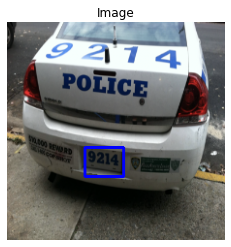

In [ ]:
showImageWithAnnot(images[150], annotations[150])

# Splitting the Data

In [ ]:
# Splitting data

X, X_test, y, y_test = train_test_split(images, annotations, test_size=0.1, random_state=32, shuffle=False)

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=32, shuffle=False)


print("Xtrain:", len(X_train), "Ytrain:", len(y_train))
print("Xval:", len(X_val), "Yval:", len(y_val))
print("Xtest:", len(X_test), "Ytest:", len(y_test))

Xtrain: 340 Ytrain: 340
Xval: 38 Yval: 38
Xtest: 42 Ytest: 42


In [ ]:
340+38+42

420

In [ ]:
# Creating Batches

def make_batches(X, y=None, batch_size=BATCH_SIZE, reshuffle_each_iteration=True, is_test=False, is_val=False):
    if is_test:
      print("Creating Test Data batches...")
      data = tf.data.Dataset.from_tensor_slices(tf.constant(X))
      data_batch = data.batch(BATCH_SIZE)
      return data_batch
    
    elif is_val:
      print("Creating Validation Data batches...")    
      data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
      data_batch = data.batch(BATCH_SIZE)
      return data_batch

    print("Creating Training Data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    data = data.shuffle(len(X), reshuffle_each_iteration=reshuffle_each_iteration)
    data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [ ]:
train_data = make_batches(X_train, y_train)
test_data = make_batches(X_test, is_test=True)
val_data = make_batches(X_val, y_val, is_val=True)
full_data = make_batches(images, annotations)

Creating Training Data batches...
Creating Test Data batches...
Creating Validation Data batches...
Creating Training Data batches...


In [ ]:
images.shape

(420, 225, 225, 3)

In [ ]:
def view_images(images, labels, n=25):
    plt.figure(figsize=(10, 10))
    
    for i in range(n):
        ax = plt.subplot(5, 5, i+1)
        ax.imshow(images[i])
        # ax.set_title(unique_breeds[labels[i].argmax()], fontsize=14)
        ax.axes.xaxis.set_visible(False)
        ax.axes.yaxis.set_visible(False)

In [ ]:
xx, yy = next(train_data.as_numpy_iterator())

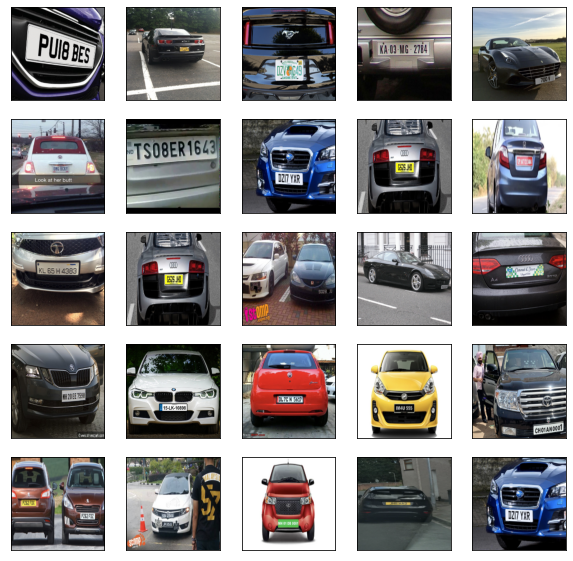

In [ ]:
view_images(xx, yy)

## 6. Model Building

In [ ]:
from tensorflow.keras import regularizers
model = tf.keras.Sequential()

# model.add(tf.keras.layers.Reshape( (300,400,3) )   )
model.add( tf.keras.layers.Conv2D(filters = 32, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu', input_shape=(225,225,3) )  ) # 298*398*32
model.add(tf.keras.layers.Conv2D(filters = 32, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' ))   # 296*396*32
model.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 148 , 198 , 32
model.add( tf.keras.layers.BatchNormalization())
model.add( tf.keras.layers.Conv2D(filters = 64, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' )  ) # 146*196*64
model.add(tf.keras.layers.Conv2D(filters = 64, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu'))   # 144*194*64
model.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 74 , 97 , 32
model.add( tf.keras.layers.BatchNormalization())
model.add( tf.keras.layers.Conv2D(filters = 128, kernel_size= 3 , strides=(1,1), padding="valid", activation='leaky_relu' )  ) # 72*95*128
model.add(tf.keras.layers.Conv2D(filters = 128, kernel_size= 3 , strides=(1,1), padding="valid", activation='leaky_relu' ))   # 70*93*128
model.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 35 , 46 , 32
model.add( tf.keras.layers.BatchNormalization())

model.add( tf.keras.layers.Conv2D(filters = 256, kernel_size= 3 , strides=(1,1), padding="valid" , activation='relu')  ) # 33*44*256

model.add( tf.keras.layers.BatchNormalization())

model.add(tf.keras.layers.GlobalAveragePooling2D() )
model.add(tf.keras.layers.Dropout(0.2))
model.add(tf.keras.layers.Dense(256, activation="relu") )
# model.add(tf.keras.layers.Dropout(0.2))
model.add(tf.keras.layers.Dense(64, activation="relu") )

model.add(tf.keras.layers.Dense(4) )








In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam() , loss="mse", metrics="accuracy" )

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 223, 223, 32)      896       
                                                                 
 conv2d_1 (Conv2D)           (None, 221, 221, 32)      9248      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_2 (Conv2D)           (None, 108, 108, 64)      18496     
                                                                 
 conv2d_3 (Conv2D)           (None, 106, 106, 64)      3

In [ ]:
BATCH_SIZE

32

In [ ]:
earlyStoppingCallback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=20,
    verbose=1,
    mode='auto',
    # baseline=None,
    # restore_best_weights=False
)

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard( 'tensorboard_logs' , histogram_freq=1)

In [ ]:
hist = model.fit(
    # full_data,
    train_data,
    epochs=200,
    validation_data=val_data,
    # validation_split=0.25,
    batch_size=BATCH_SIZE,
    verbose=2,
    callbacks = [tensorboard_callback]
    # callbacks = [earlyStoppingCallback]

    )


# model_history=model.fit(X_train,y_train,validation_data=(X_test,y_test),batch_size=10,epochs=100,callbacks=early_stopping)

Epoch 1/200
11/11 - 18s - loss: 17596.4941 - accuracy: 0.2235 - val_loss: 16666.1055 - val_accuracy: 0.5789 - 18s/epoch - 2s/step
Epoch 2/200
11/11 - 2s - loss: 15677.7695 - accuracy: 0.3029 - val_loss: 14171.6777 - val_accuracy: 0.5263 - 2s/epoch - 204ms/step
Epoch 3/200
11/11 - 2s - loss: 11367.0703 - accuracy: 0.2735 - val_loss: 3236.4551 - val_accuracy: 0.5789 - 2s/epoch - 192ms/step
Epoch 4/200
11/11 - 2s - loss: 6399.0913 - accuracy: 0.3471 - val_loss: 1078.0055 - val_accuracy: 0.5789 - 2s/epoch - 175ms/step
Epoch 5/200
11/11 - 2s - loss: 5153.8042 - accuracy: 0.5147 - val_loss: 965.2661 - val_accuracy: 0.4211 - 2s/epoch - 176ms/step
Epoch 6/200
11/11 - 2s - loss: 4676.6045 - accuracy: 0.5265 - val_loss: 2441.5464 - val_accuracy: 0.4211 - 2s/epoch - 178ms/step
Epoch 7/200
11/11 - 2s - loss: 3043.4878 - accuracy: 0.5265 - val_loss: 1267.9155 - val_accuracy: 0.4211 - 2s/epoch - 176ms/step
Epoch 8/200
11/11 - 2s - loss: 2414.3308 - accuracy: 0.5265 - val_loss: 1524.9694 - val_accura

In [ ]:
model.save("DetectionModel1.h5")

In [ ]:
!pwd

/content/drive/MyDrive/Deep_Learning_Project1


In [ ]:
len(os.listdir("dataset/images")), len(os.listdir("dataset/annotations"))

(420, 493)

In [ ]:
!ls

 Capture1.JPG	       FullData_DetectionModel1.h5
 Capture2.JPG	       ResNet50V2.h5
 Capture.JPG	       tensorboard_logs
 DataFormation.ipynb   tensorboard_logs.txt
 dataset	       test1.jpeg
 DetectionModel1.h5    test2.jpeg
 download.jpeg	       test3.jpeg
 finalData.csv	      'Vehicle Classification.ipynb'


In [ ]:
%tensorboard --logdir "tensorboard_logs" 


<IPython.core.display.Javascript object>

## Model 2


In [ ]:
from tensorflow.keras import regularizers
model2 = tf.keras.Sequential()

# model.add(tf.keras.layers.Reshape( (300,400,3) )   )
model2.add( tf.keras.layers.Conv2D(filters = 64, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu', input_shape=(225,225,3) )  ) # 298*398*32
model2.add(tf.keras.layers.Conv2D(filters = 64, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' ))   # 296*396*32
model2.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 148 , 198 , 32
model2.add( tf.keras.layers.BatchNormalization())
model2.add( tf.keras.layers.Conv2D(filters = 128, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' )  ) # 146*196*64
model2.add(tf.keras.layers.Conv2D(filters = 128, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu'))   # 144*194*64
model2.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 74 , 97 , 32
model2.add( tf.keras.layers.BatchNormalization())
model2.add( tf.keras.layers.Conv2D(filters = 256, kernel_size= 3 , strides=(1,1), padding="valid", activation='leaky_relu' )  ) # 72*95*128
model2.add(tf.keras.layers.Conv2D(filters = 256, kernel_size= 3 , strides=(1,1), padding="valid", activation='leaky_relu' ))   # 70*93*128
model2.add(tf.keras.layers.Conv2D(filters = 256, kernel_size= 3 , strides=(1,1), padding="valid", activation='leaky_relu' ))   # 70*93*128
model2.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 35 , 46 , 32
model2.add( tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="same", activation='relu' )  ) # 72*95*128
model2.add(tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="same", activation='relu' ))   # 70*93*128
model2.add(tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="same", activation='relu' ))   # 70*93*128
model2.add( tf.keras.layers.MaxPool2D(pool_size=(2,2)) )  # 35 , 46 , 32
model2.add( tf.keras.layers.BatchNormalization())
model2.add( tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' )  ) # 72*95*128
model2.add(tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' ))   # 70*93*128
model2.add(tf.keras.layers.Conv2D(filters = 512, kernel_size= 3 , strides=(1,1), padding="valid", activation='relu' ))   # 70*93*128

model2.add( tf.keras.layers.BatchNormalization())

model2.add(tf.keras.layers.GlobalAveragePooling2D() )
model2.add(tf.keras.layers.Dropout(0.2))
model2.add(tf.keras.layers.Dense(256, activation="relu") )
model2.add(tf.keras.layers.Dropout(0.2))
model2.add(tf.keras.layers.Dense(64, activation="relu") )

model2.add(tf.keras.layers.Dense(4) )








In [ ]:
model2.compile(optimizer=tf.keras.optimizers.Adam() , loss="mse", metrics="accuracy" )

In [ ]:
model2.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_34 (Conv2D)          (None, 223, 223, 64)      1792      
                                                                 
 conv2d_35 (Conv2D)          (None, 221, 221, 64)      36928     
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 110, 110, 64)     0         
 g2D)                                                            
                                                                 
 batch_normalization_12 (Bat  (None, 110, 110, 64)     256       
 chNormalization)                                                
                                                                 
 conv2d_36 (Conv2D)          (None, 108, 108, 128)     73856     
                                                                 
 conv2d_37 (Conv2D)          (None, 106, 106, 128)    

In [ ]:
tensorboard_callback = tf.keras.callbacks.TensorBoard( 'tensorboard_logs2' , histogram_freq=1)

In [ ]:
model2.fit(
      # full_data,
    train_data,
    epochs=200,
    validation_data=val_data,
    # validation_split=0.25,
    batch_size=BATCH_SIZE,
    verbose=2,
    callbacks = [tensorboard_callback]
    # callbacks = [earlyStoppingCallback]

    )

Epoch 1/200
11/11 - 27s - loss: 16898.7129 - accuracy: 0.3382 - val_loss: 1092256.1250 - val_accuracy: 0.4211 - 27s/epoch - 2s/step
Epoch 2/200
11/11 - 7s - loss: 12087.8320 - accuracy: 0.4676 - val_loss: 9125.7520 - val_accuracy: 0.5789 - 7s/epoch - 626ms/step
Epoch 3/200
11/11 - 7s - loss: 6130.0825 - accuracy: 0.4206 - val_loss: 258340.1094 - val_accuracy: 0.5789 - 7s/epoch - 626ms/step
Epoch 4/200
11/11 - 7s - loss: 3780.9724 - accuracy: 0.4706 - val_loss: 5824.8110 - val_accuracy: 0.4474 - 7s/epoch - 629ms/step
Epoch 5/200
11/11 - 7s - loss: 2811.1975 - accuracy: 0.5235 - val_loss: 2034.5989 - val_accuracy: 0.4211 - 7s/epoch - 629ms/step
Epoch 6/200
11/11 - 7s - loss: 2014.6914 - accuracy: 0.5294 - val_loss: 1485.0076 - val_accuracy: 0.4211 - 7s/epoch - 628ms/step
Epoch 7/200
11/11 - 8s - loss: 1690.6842 - accuracy: 0.5471 - val_loss: 4296.3320 - val_accuracy: 0.4211 - 8s/epoch - 682ms/step
Epoch 8/200
11/11 - 7s - loss: 1731.4517 - accuracy: 0.5382 - val_loss: 2275.4712 - val_acc

In [ ]:
model2.save("DetectionModel2.h5")

In [ ]:
%tensorboard --logdir "tensorboard_logs2" 


<IPython.core.display.Javascript object>

## Testing Model

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img

In [ ]:
image = load_img("dataset/images/Cars190.png")

image = img_to_array( image)

# image = image.reshape( (1,) + image.shape )

In [ ]:
image = resizeAndScale(image)

image = image.reshape( (1,) + image.shape )

In [ ]:
loadedModel = tensorflow.keras.models.load_model(filepath="DetectionModel2.h5" )
model2 = tensorflow.keras.models.load_model(filepath="DetectionModel2.h5" )

In [ ]:
  # next(test_data.as_numpy_iterator()).shape

In [ ]:
# LoadedModel.predict(image)
# LoadedModel.predict(test_data)
# model.evaluate(val_data)
# xmin , ymin, xmax, ymax = loadedModel.predict(test_data)
print("Test Data")
print(model.evaluate(X_test, y_test))
print("Val Data")
print(model.evaluate(X_val, y_val))

print("train Data")
print( model.evaluate(X_train, y_train) )

# print(model.evaluate(test_data))
model.compute_loss()
# list(LoadedModel.predict(image)[0])

Test Data
2/2 [==============================] - 1s 427ms/step - loss: 771.8369 - accuracy: 0.8108
[771.8369140625, 0.8108108043670654]
Val Data
2/2 [==============================] - 0s 9ms/step - loss: 633.6880 - accuracy: 0.8529
[633.68798828125, 0.8529411554336548]
train Data
10/10 [==============================] - 1s 88ms/step - loss: 142.3280 - accuracy: 0.9231
[142.32797241210938, 0.9230769276618958]


### Testing On Single Image

In [ ]:
# img = cv2.imread('dataset/images/Cars190.png')
img = cv2.imread('Capture2.JPG')

In [ ]:
img = resizeAndScale(img)

In [ ]:
# img = np.expand_dims(img, 0)

In [ ]:
np.array([img]).shape

(1, 225, 225, 3)

In [ ]:
images[1].shape

(225, 225, 3)

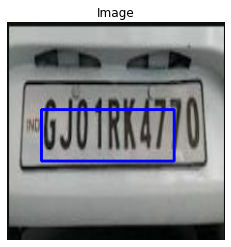

In [ ]:
showImageWithAnnot(img , pred)
# showImageWithAnnot(img, np.array([82.309074, 100.440636, 111.383766, 116.59656]))

## Show all images using model

14/14 [==============================] - 160s 11s/step


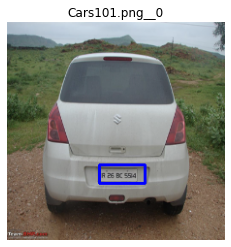

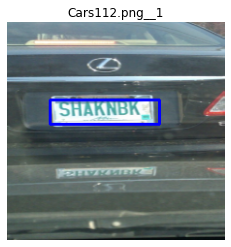

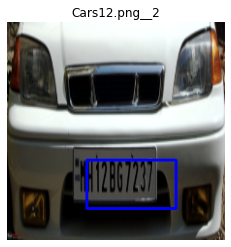

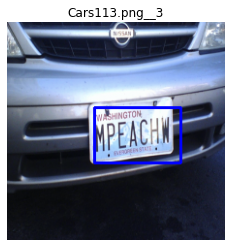

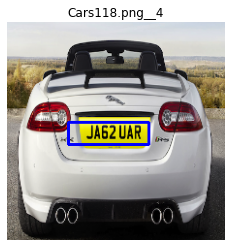

...

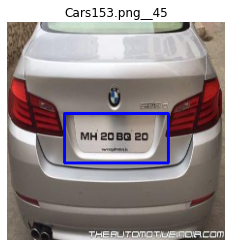

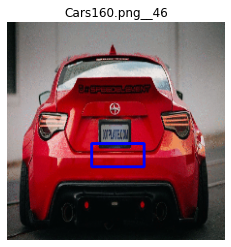

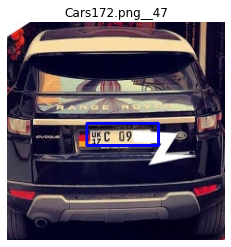

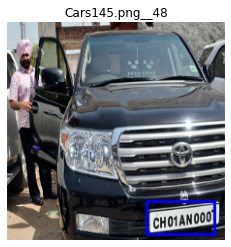

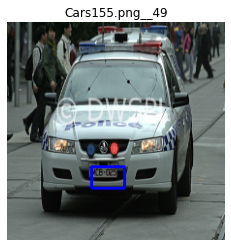

In [ ]:
imageNames = [os.path.join("dataset", "images", x) for x in os.listdir(images_path)]


# imageNames = [os.path.join("dataset", "images", x) for x in os.listdir(images_path)]
# annotNames = [imageName.replace("images", "annotations").replace(".png", ".xml") for imageName in imageNames]
pred = loadedModel.predict(images)


for image,annot,c,name in zip(images[:50], pred[:50], range(len(pred[:50])), imageNames[:50]):
  # annotName = name.replace("images", "annotations").replace(".png", ".xml")
  # annotName = name.replace("images", "annotations").replace(name.replace("images", "annotations").split('.')[1], "xml")
  # if 'download' in name:
      # image, annot = getImageAndAnnot(name, getBoundingBox(annotName))
      
      showImageWithAnnot(image, annot, title = name.split('/')[-1]+'__'+str(c))






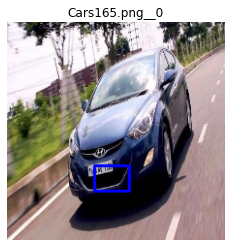

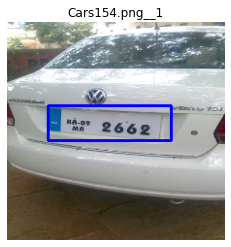

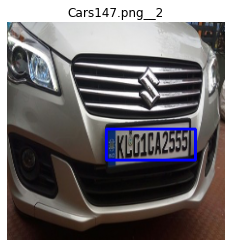

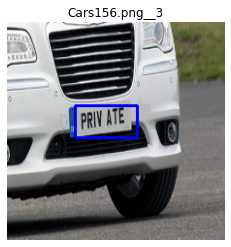

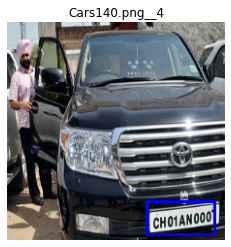

...

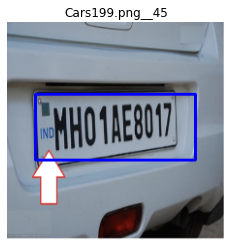

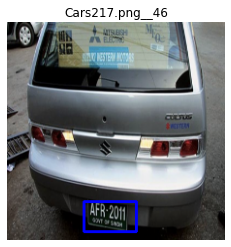

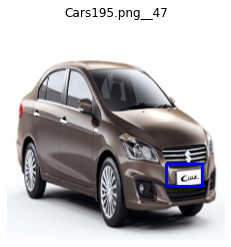

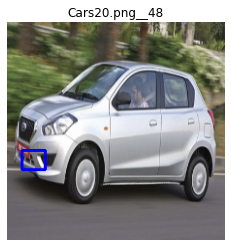

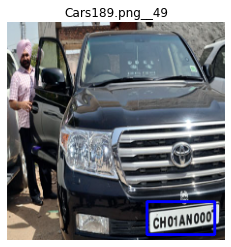

In [ ]:
for image,annot,c,name in zip(images[50:100], pred[50:100], range(len(pred[50:100])), imageNames[50:100]):
  # annotName = name.replace("images", "annotations").replace(".png", ".xml")
  # annotName = name.replace("images", "annotations").replace(name.replace("images", "annotations").split('.')[1], "xml")
  # if 'download' in name:
      # image, annot = getImageAndAnnot(name, getBoundingBox(annotName))
      
      showImageWithAnnot(image, annot, title = name.split('/')[-1]+'__'+str(c))



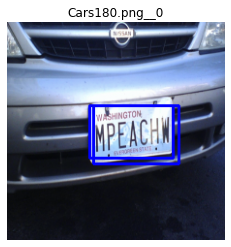

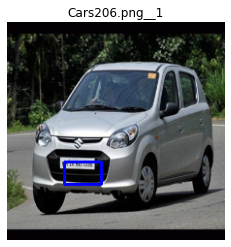

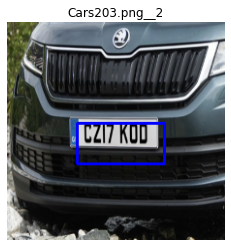

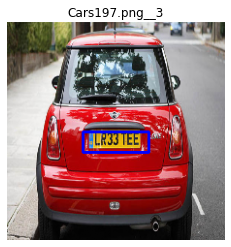

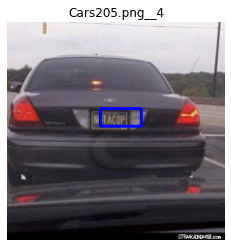

...

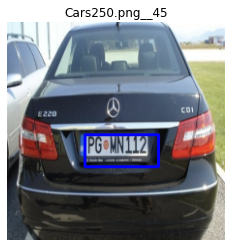

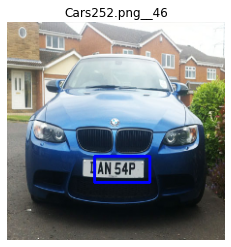

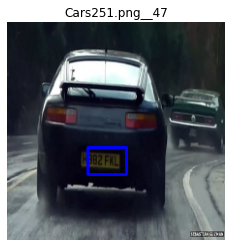

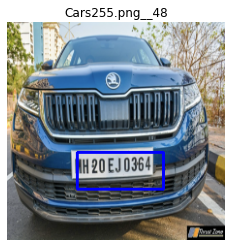

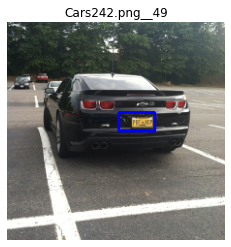

In [ ]:

for image,annot,c,name in zip(images[100:150], pred[100:150], range(len(pred[100:150])), imageNames[100:150]):
  # annotName = name.replace("images", "annotations").replace(".png", ".xml")
  # annotName = name.replace("images", "annotations").replace(name.replace("images", "annotations").split('.')[1], "xml")
  # if 'download' in name:
      # image, annot = getImageAndAnnot(name, getBoundingBox(annotName))
      
      showImageWithAnnot(image, annot, title = name.split('/')[-1]+'__'+str(c))



# OCR

### Trying OCR Model Pretrained

In [ ]:
!pip install pytesseract

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# All Installations

!pip install pytesseract
!pip install tesseract
!pip install tesseract-ocr


!sudo apt-get update
!sudo apt-get install libleptonica-dev tesseract-ocr tesseract-ocr-dev libtesseract-dev python3-pil tesseract-ocr-eng tesseract-ocr-script-latn

!sudo apt-get install tesseract-ocr



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached tesseract-ocr-0.0.1.tar.gz (33 kB)
  ERROR: Failed building wheel for tesseract-ocr
  Running setup.py clean for tesseract-ocr
Failed to build tesseract-ocr
    Running setup.py install for tesseract-ocr ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-4y395g7f/tesseract-ocr_05558bdfbe0c48a8825d395cf8f10847/setup.py'"'"'; __file__='"'"'/tmp/pip-install-4y395g7f/tesseract-ocr_05558bdfbe0c48a8825d395cf8f10847/setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code 

## 1. OCR1 - pytesseract

In [ ]:
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'


In [ ]:
import pytesseract

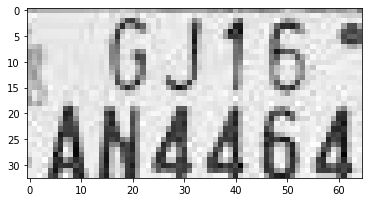

In [ ]:
config = ('-l eng --oem 1 --psm 3')
from PIL import Image

# sp = cv2.imread("download.jpeg", flags = 0)
sp = cv2.imread("test3.jpeg", flags = 0)
# sp = cv2.imread("Capture2.JPG", flags = 0)
# plt.imshow(sp)

sp = sp[97:130, 70:135]
# sp = cv2.threshold (cv2.cvtColor( cv2.erode(sp, kernel = np.ones((2,2)), iterations=1) , cv2.COLOR_BGR2GRAY ),thresh=127.5, maxval = 255, type = cv2.THRESH_BINARY )[1]
plt.imshow(sp, cmap='gray')
# text = pytesseract.image_to_string(sp, config=config)
text = pytesseract.image_to_string(cv2.erode(sp, kernel = np.ones((2,2))), config=config)

# text = pytesseract.image_to_string(sp, config=config)

In [ ]:
print(text)

## Validation 

In [ ]:
def validation_update(string):
  special_characters =list("!@#$%^&*()-+?_=,<>/")
  pos = 0
  for ch,pos in zip(string , range(len(string))):
    if ch in special_characters:
      string = string.replace(ch, '')
  return string.strip()





In [ ]:
validation_update(text)

'GJO1RKA770'

## 2. OCR2 - HuggingFace Transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.5 MB 1.3 MB/s 
     |████████████████████████████████| 182 kB 54.5 MB/s 
     |████████████████████████████████| 7.6 MB 35.0 MB/s 
Hit:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease
Ign:2 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:3 http://security.ubuntu.com/ubuntu bionic-security InRelease
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Hit:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Hit:6 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease
Hit:7 http://archive.ubuntu.com/ubuntu bionic InRelease
Hit:8 http://archive.ubuntu.com/ubuntu bionic-updates InRelease
Hit:9 http://archive.ubuntu.com/ubuntu bionic-backports InRelease
Hit:10 http://ppa.launchpa

Downloading:   0%|          | 0.00/228 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.12k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/772 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.13k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.33G [00:00<?, ?B/s]

Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-base-handwritten and are newly initialized: ['encoder.pooler.dense.bias', 'encoder.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.




 <class 'PIL.JpegImagePlugin.JpegImageFile'> 




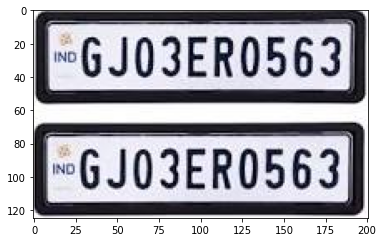

In [ ]:
!pip install transformers
!sudo apt-get update
!sudo apt-get install libleptonica-dev tesseract-ocr tesseract-ocr-dev libtesseract-dev python3-pil tesseract-ocr-eng tesseract-ocr-script-latn

# !pip install tesseract
# !pip install tesseract-ocr

# !pip install pytesseract
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
# import requests 
# from PIL import Image

processor = TrOCRProcessor.from_pretrained("microsoft/trocr-base-handwritten") 
model = VisionEncoderDecoderModel.from_pretrained("microsoft/trocr-base-handwritten")

# load image from the IAM dataset 
# url = "https://fki.tic.heia-fr.ch/static/img/a01-122-02.jpg" 
# image = Image.open(requests.get(url, stream=True).raw)
image = Image.open("download.jpeg")

# print(image)
plt.imshow(image)
print('\n\n',type(image),'\n\n')
pixel_values = processor(image, return_tensors="pt").pixel_values 
generated_ids = model.generate(pixel_values)

generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0] 

In [ ]:
generated_text

'0 0'

In [ ]:
cd labelImg-master 
brew install qt 
brew install libxml2 
make qt5py3 
python labelImg.py

SyntaxError: ignored

## 3. OCR3 - YOLO

In [ ]:
!pwd

/content/drive/MyDrive/Deep_Learning_Project1


In [ ]:
cd yolo-license-plate-detection/

/content/drive/MyDrive/Deep_Learning_Project1/yolo-license-plate-detection


In [ ]:
!git clone https://github.com/misbah4064/yolo-license-plate-detection.git
%cd yolo-license-plate-detection

fatal: destination path 'yolo-license-plate-detection' already exists and is not an empty directory.
/content/drive/MyDrive/Deep_Learning_Project1/yolo-license-plate-detection


In [ ]:
!gdown https://drive.google.com/uc?id=1vXjIoRWY0aIpYfhj3TnPUGdmJoHnWaOc

Downloading...
From: https://drive.google.com/uc?id=1vXjIoRWY0aIpYfhj3TnPUGdmJoHnWaOc
To: /content/drive/MyDrive/Deep_Learning_Project1/yolo-license-plate-detection/model.weights
100% 245M/245M [00:01<00:00, 222MB/s]


In [ ]:
import cv2
import numpy as np

def objectDetector(img):
    yolo = cv2.dnn.readNet("model.weights", "darknet-yolov3.cfg")
    classes = []

    with open("classes.names", "r") as file:
        classes = [line.strip() for line in file.readlines()]
    layer_names = yolo.getLayerNames()
    output_layers = [layer_names[i - 1] for i in yolo.getUnconnectedOutLayers()]

    colorRed = (0,0,255)
    colorGreen = (0,255,0)
    colorWhite = (255,255,255)

    height, width, channels = img.shape

    # # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    yolo.setInput(blob)
    outputs = yolo.forward(output_layers)

    class_ids = []
    confidences = []
    boxes = []
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    xmin, ymin, xmax, ymax = 0,0,0,0
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            # xmin, ymin, xmax, ymax = (x, y), (x + w, y + h)
            xmin, ymin  = x , y
            xmax , ymax = x + w, y + h

            label = str(classes[class_ids[i]])
            cv2.rectangle(img, (x, y), (x + w, y + h), colorGreen, 3)
            cv2.putText(img, label, (x, y - 30), cv2.FONT_HERSHEY_PLAIN, 3, colorWhite, 2)
    return img, [xmin, ymin, xmax, ymax]

In [ ]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

# input_image = cv2.imread("car0.JPG")
failCount =  0
for img, c in zip(os.listdir("dataset/images"), range(len(os.listdir("dataset/images")))):
  if c%1 == 0:
    input_image = cv2.imread(os.path.join("dataset/images/", img))
    image, [xmin, ymin, xmax, ymax] = objectDetector(input_image)
    if xmin==0 and ymin==0 and xmax==0 and ymax==0:
      failCount += 1
    else:
      height, width = image.shape[:2]
      resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

      fig = plt.gcf()
      fig.set_size_inches(18, 10)
      plt.title(img)
      # plt.axis("off")
      plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))

      plt.show()
      print((xmin, ymin, xmax, ymax))
      print("\n\n\n")

In [ ]:
failCount

214

In [ ]:
# Checking Fail Counts


# input_image = cv2.imread("car0.JPG")
failCount =  0
for img, c in zip(os.listdir("dataset/images"), range(len(os.listdir("dataset/images")))):
  if c%1 == 0:
    input_image = cv2.imread(os.path.join("dataset/images/", img))
    image, [xmin, ymin, xmax, ymax] = objectDetector(input_image)
    if xmin==0 and ymin==0 and xmax==0 and ymax==0:
      failCount += 1
      # print(xmin, ymin, xmax, ymax)
print("failcoint :", failCount)
print("Total :",len(os.listdir("dataset/images")))

failcoint : 214
Total : 370


In [ ]:
214/370

0.5783783783783784

In [ ]:
100-57

43

## Linkedin Post

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

#detecting license plate on the vehicle
plateCascade = cv2.CascadeClassifier('indian_license_plate.xml')


def plate_detect(img):
    plateImg = img.copy()
    roi = img.copy()
    plateRect = plateCascade.detectMultiScale(plateImg,scaleFactor = 1.2, minNeighbors = 7)
    
    for (x,y,w,h) in plateRect:
        roi_ = roi[y:y+h, x:x+w, :]
        plate_part = roi[y:y+h, x:x+w, :]
        cv2.rectangle(plateImg,(x+2,y),(x+w-3, y+h-5),(0,255,0),3)
    return plateImg, plate_part

In [ ]:
plate_detect(images[0])
# plt.imshow(images[0])

error: ignored